This notebook reproduces the experimental results presented in our manuscript. Instructions for accessing the data are available in /data/README.md.

In [1]:
import scanpy as sc
import os
import sys
import numpy as np

sys.path.append('../model/') 
# the location of R, which is required for the 'mclust' algorithm. Please replace the path below with local R installation path
os.environ['R_HOME'] = '/home/ws6tg/anaconda3/envs/EnvR43/lib/R/'

from utils import clustering
import matplotlib.pyplot as plt

from utils import set_seed
set_seed(2024)

In [2]:
data_path="../datasets/stereo_C04776D6/"
adatas={}

In [4]:
for bin_size in [200,150,100,50,20,10]:
    adatas[bin_size]=sc.read_h5ad(f'../results/different_resolution/adata_SMART_bin{bin_size}.h5ad')

In [ ]:
import matplotlib.pyplot as plt

#for bin_size in [200,150,100,50,20,10]:
for bin_size in [5]:
    adata_omics1 = sc.read_h5ad(data_path + f'C04776D6_rna_bin{bin_size}.h5ad')
    adata_omics2 = sc.read_h5ad(data_path + f'C04776D6_adt_bin{bin_size}.h5ad')
    
    
    adata_omics1.var_names_make_unique()
    adata_omics2.var_names_make_unique()
    
    obs_names=adata_omics1.obs_names.intersection(adata_omics2.obs_names)
    adata_omics1=adata_omics1[obs_names].copy()
    adata_omics2=adata_omics2[obs_names].copy()
    
    import numpy as np
    adata_omics2.X=adata_omics2.X.astype(np.float32)
    adata_omics2.X
    
    import sys
    sys.path.append('../../model/') 
    
    from utils import pca
    
    # RNA
    sc.pp.filter_genes(adata_omics1, min_cells=10)
    sc.pp.highly_variable_genes(adata_omics1, flavor="seurat_v3", n_top_genes=5000)
    
    sc.pp.normalize_total(adata_omics1, target_sum=1e4)
    sc.pp.log1p(adata_omics1)
    #sc.pp.scale(adata_omics1)
    adata_omics1_high = adata_omics1[:, adata_omics1.var['highly_variable']]
    adata_omics1.obsm['pca'] = pca(adata_omics1_high, n_comps=30)
    
    from muon import prot as pt
    from utils import pca
    # Protein
    pt.pp.clr(adata_omics2)
    #clr_normalize_each_cell(adata_omics2)
    sc.pp.scale(adata_omics2)
    
    adata_omics2.obsm['pca'] = pca(adata_omics2, n_comps=30)
    adata_omics1.obsm['ADT'] = adata_omics2.obsm['pca']
     # read data
    

In [73]:
import matplotlib.pyplot as plt
from utils import Cal_Spatial_Net
from utils import Mutual_Nearest_Neighbors
from train import train_SMART
from utils import clustering
import torch
import time

device=torch.device("cuda:1")
#!nvidia-smi
adata_list=[adata_omics1,adata_omics2]
x = [torch.FloatTensor(adata.obsm["pca"]).to(device) for adata in adata_list]
triplet_samples_list = [Mutual_Nearest_Neighbors(adata, key="pca", n_nearest_neighbors=2,farthest_ratio=0.6,max_samples=30000) for adata in adata_list]


Cal_Spatial_Net(adata_omics1, model="KNN", n_neighbors=4)
Cal_Spatial_Net(adata_omics2, model="KNN", n_neighbors=4)
edges =[torch.LongTensor(adata.uns["edgeList"]).to(device) for adata in adata_list ]


t1=time.time()
model=train_SMART(features=x,
    edges=edges,
    triplet_samples_list=triplet_samples_list,
    weights=[1,1,1,1],
    emb_dim=64, 
    n_epochs=400,
    lr=0.005,
    weight_decay=1e-5,
    device = device,
    window_size=10,
    slope=0.0001,)

adata_omics1.obsm["SMART"]=model(x, edges)[0].cpu().detach().numpy()
t2=time.time()
print(t2-t1)
#!nvidia-smi

tool = 'mclust'  # mclust, leiden, and louvain
clustering(adata_omics1, key='SMART', add_key='SMART', n_clusters=6, method=tool, use_pca=True)
clustering(adata_omics1, key='pca', add_key='RNA', n_clusters=6, method=tool, use_pca=True)
clustering(adata_omics1, key='ADT', add_key='ADT', n_clusters=6, method=tool, use_pca=True)
adatas[bin_size]=adata_omics1

{200: AnnData object with n_obs × n_vars = 2001 × 25082
     obs: 'orig.ident', 'x', 'y', 'mclust', 'SMART', 'RNA', 'ADT'
     var: 'real_gene_name', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
     uns: 'bin_size', 'bin_type', 'key_record', 'merged', 'resolution', 'sn', 'hvg', 'log1p', 'adj', 'edgeList', 'SMART_colors', 'RNA_colors', 'ADT_colors'
     obsm: 'spatial', 'pca', 'ADT', 'SMART', 'SMART_pca', 'pca_pca', 'ADT_pca',
 150: AnnData object with n_obs × n_vars = 3507 × 25086
     obs: 'orig.ident', 'x', 'y', 'mclust', 'SMART', 'RNA', 'ADT'
     var: 'real_gene_name', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
     uns: 'bin_size', 'bin_type', 'key_record', 'merged', 'resolution', 'sn', 'hvg', 'log1p', 'adj', 'edgeList', 'SMART_colors', 'RNA_colors', 'ADT_colors'
     obsm: 'spatial', 'pca', 'ADT', 'SMART', 'SMART_pca', 'pca_pca', 'ADT_pca',
 100: AnnData object with n_obs × n_vars =

5
6
3


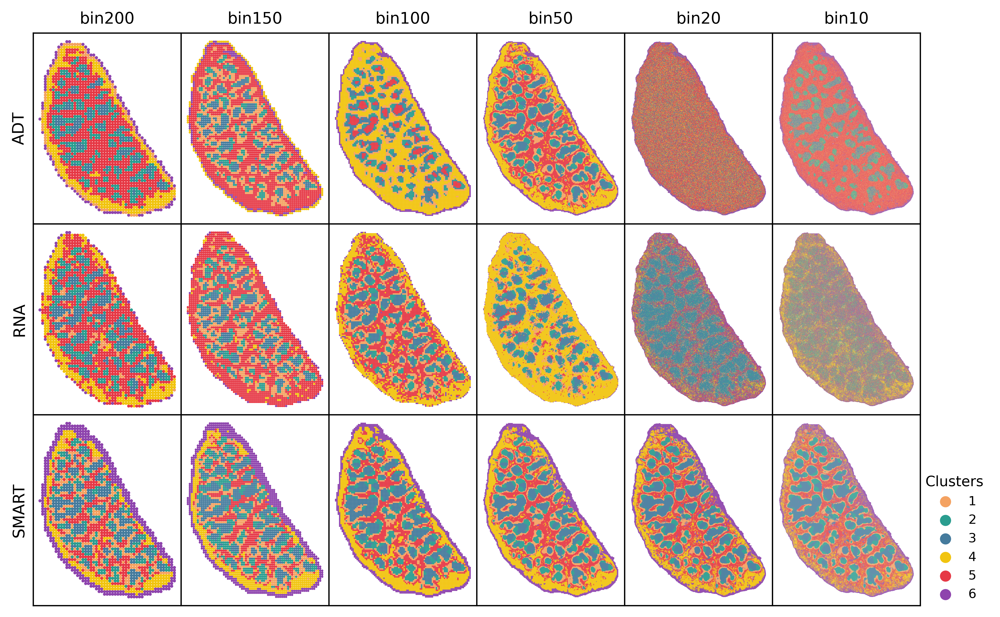

In [8]:
from utils import getcolordict

plt.rcParams["axes.titlesize"] = 10
plt.rcParams["legend.fontsize"] = 8               
plt.rcParams["legend.title_fontsize"] = 9 


ss=[15,8,4,1,0.2,0.05]
s_dict={
    200:15,
    150:8,
    100:4,
    50:1,
    20:0.2,
    10:0.05,
}

fig, ax_list = plt.subplots(3, 6, figsize=(10, 6.5),dpi=600)
plt.subplots_adjust(hspace=0,wspace=0)
for i,n in enumerate(['ADT','RNA','SMART']):
    for k,j in enumerate([200,150,100,50,20,10]):
        if n=='SMART':   
            sc.pl.embedding(adatas[j], basis='spatial', color=n,s=s_dict[j], palette=color_dict[j],ax=ax_list[i][k],show=False)
        else:
            sc.pl.embedding(adatas[j], basis='spatial', color=n,s=s_dict[j], palette=getcolordict(adatas[j],n,"SMART",color_dict[j]),
                            ax=ax_list[i][k],show=False)
        
        ax_list[i][k].set_title(f"bin{j}" if i==0 else "") 
        ax_list[i][k].set_xlabel("")
        ax_list[i][k].set_ylabel(n if k==0 else "")
        ax_list[i][k].get_legend().remove()
ax_list[2][5].legend(frameon=False,loc=(1,0),title='Clusters')   
plt.show()
fig.savefig("cluster.jpg",format="jpg",bbox_inches='tight',transparent=True)

## SMART

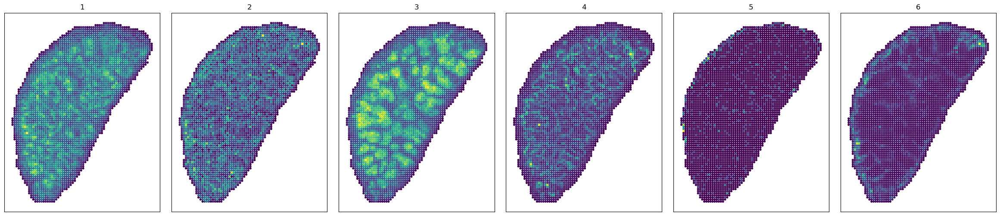

In [44]:
fig, ax_list = plt.subplots(1, 6, figsize=(5*6, 6))
plt.subplots_adjust(hspace=0.01,wspace=0.01)

for k,j in enumerate(top3_per_cluster["names"]):
    sc.pl.spatial(adata_omics1,img_key=None,title=f"{k+1}",color=j,spot_size=bin_size*1.1,ax=ax_list[k],show=False,colorbar_loc=None)
    #sc.pl.embedding(adata_omics1, basis='spatial', color='SMART',s=bin_size, palette={i+1:color_dict[j+1] if i==j else "#DCDCDC" for i in range(6)},ax=ax_list[j],title=str(j+1),show=False)
    ax_list[k].set_xlabel("")
    ax_list[k].set_ylabel("")
    #ax_list[k].get_legend().remove()
#ax_list[2][4].remove()
#plt.tight_layout(w_pad=0.4)
plt.show()

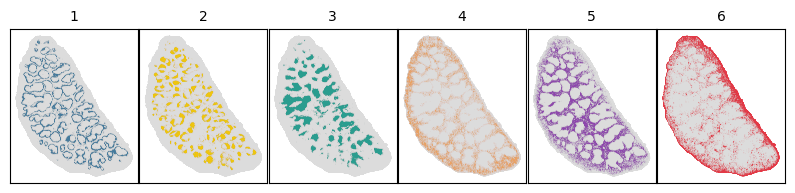

In [30]:
fig, ax_list = plt.subplots(1, 6, figsize=(10, 2))
plt.subplots_adjust(hspace=0.01,wspace=0.01)
for k,j in enumerate([1,2,3,4,5,6]):
    #sc.pl.spatial(adata_omics1,img_key=None,title=f"{k+1}",color="SMART",spot_size=bin_size*1.2,ax=ax_list[k],show=False,palette={i+1:color_dict[j] if i==j-1 else "#DCDCDC" for i in range(6)})
    sc.pl.embedding(adatas[10], basis='spatial', color='SMART',s=b*0.05, palette={i+1:color_dict[b][j] if i==j-1 else "#DCDCDC" for i in range(6)},ax=ax_list[k],title=str(k+1),show=False)
    ax_list[k].set_xlabel("")
    ax_list[k].set_ylabel("")
    ax_list[k].get_legend().remove()
plt.show()

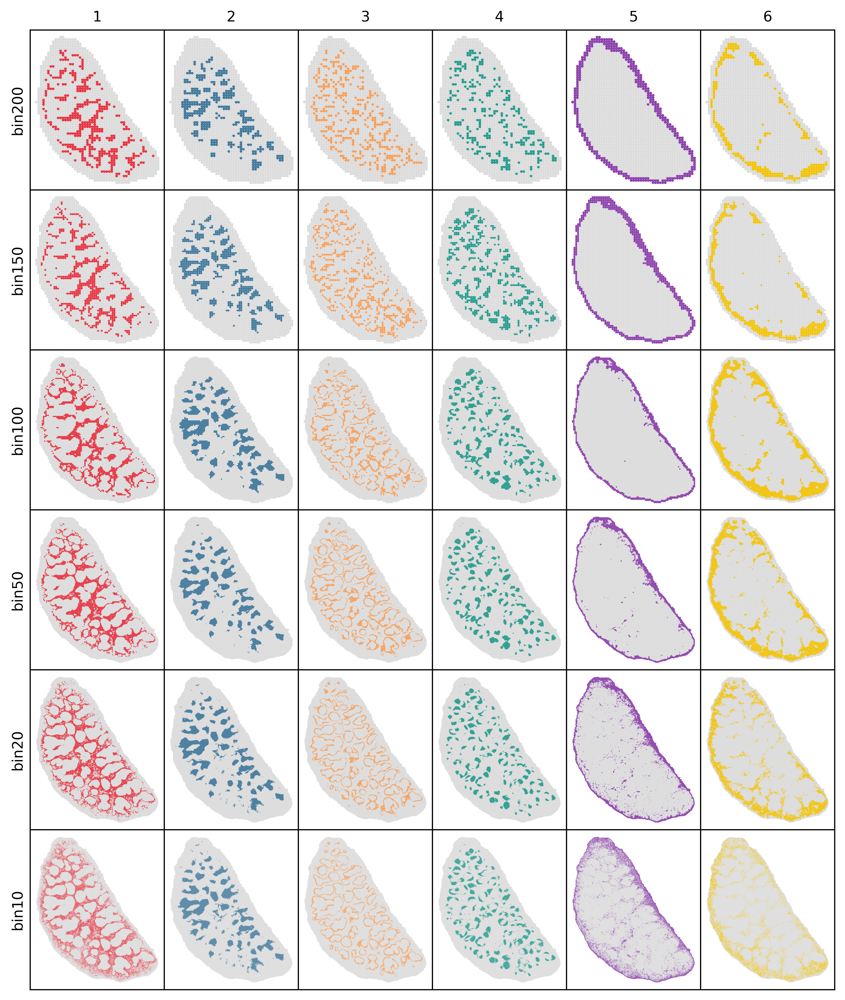

In [7]:
order=[[1,2,3,4,5,6],[2,4,3,1,5,6],[3,4,1,5,6,2],[5,2,3,4,6,1],[3,1,5,4,6,2],[5,3,1,2,6,4]]
color=['#E63946', '#457B9D', '#F4A261', '#2A9D8F','#8E44AD','#F1C40F']
color_dict={}

fig, ax_list = plt.subplots(6, 6, figsize=(10, 12),dpi=600)
plt.subplots_adjust(hspace=0,wspace=0)
for n,(b,o) in enumerate(zip([200,150,100,50,20,10],order)):
    color_dict[b]=dict(zip(o,color))
    for k,j in enumerate(o):
        #sc.pl.spatial(adata_omics1,img_key=None,title=f"{k+1}",color="SMART",spot_size=bin_size*1.2,ax=ax_list[k],show=False,palette={i+1:color_dict[j] if i==j-1 else "#DCDCDC" for i in range(6)})
        sc.pl.embedding(adatas[b], basis='spatial', color='SMART',s=s_dict[b], palette={i+1:color_dict[b][j] if i==j-1 else "#DCDCDC" for i in range(6)},ax=ax_list[n][k],show=False)
        ax_list[n][k].set_title(k+1 if n==0 else "") 
        ax_list[n][k].set_xlabel("")
        ax_list[n][k].set_ylabel(f"bin{b}" if k==0 else "")
        ax_list[n][k].get_legend().remove()
plt.show()
fig.savefig("cluster1.jpg",format="jpg",bbox_inches='tight',transparent=True)

In [88]:
for i in adatas:
    adatas[i].write_h5ad(f'../results/different_resolution/adata_SMART_bin{i}.h5ad')